In [1]:
import numpy as np
import pandas as pd
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns
import holoviews as hv
from holoviews import opts, dim
import scipy.stats as st
import statsmodels as sm
from sklearn import preprocessing
from sklearn.preprocessing import LabelEncoder, StandardScaler, PowerTransformer, QuantileTransformer, RobustScaler
from sklearn.model_selection import GridSearchCV, train_test_split, cross_val_score, cross_validate, RepeatedKFold, StratifiedKFold
from sklearn.feature_selection import RFE, RFECV
from scipy import stats
from scipy.stats import norm, skew
from scipy.special import boxcox1p
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
import warnings
warnings.filterwarnings("ignore")

In [2]:
def style_df(df_x):
    df_x = df_x.style.background_gradient(axis=0, gmap=df_x.index, cmap="mako")
    return df_x

# ***Loading The Data***

In [3]:
data = pd.read_csv("../input/pokemon-challenge/pokemon.csv")
combat_data = pd.read_csv("../input/pokemon-challenge/combats.csv")
test_data = pd.read_csv("../input/pokemon-challenge/tests.csv")

# ***EDA***

In [4]:
df = data.copy()

In [5]:
style_df(df.head())

,#,Name,Type 1,Type 2,HP,Attack,Defense,Sp. Atk,Sp. Def,Speed,Generation,Legendary
0,1,Bulbasaur,Grass,Poison,45,49,49,65,65,45,1,False
1,2,Ivysaur,Grass,Poison,60,62,63,80,80,60,1,False
2,3,Venusaur,Grass,Poison,80,82,83,100,100,80,1,False
3,4,Mega Venusaur,Grass,Poison,80,100,123,122,120,80,1,False
4,5,Charmander,Fire,nan,39,52,43,60,50,65,1,False


In [6]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
#,800.0,400.50000,231.084400,1.0,200.75,400.5,600.25,800.0
HP,800.0,69.25875,25.534669,1.0,50.00,65.0,80.00,255.0
Attack,800.0,79.00125,32.457366,5.0,55.00,75.0,100.00,190.0
Defense,800.0,73.84250,31.183501,5.0,50.00,70.0,90.00,230.0
Sp. Atk,800.0,72.82000,32.722294,10.0,49.75,65.0,95.00,194.0
Sp. Def,800.0,71.90250,27.828916,20.0,50.00,70.0,90.00,230.0
Speed,800.0,68.27750,29.060474,5.0,45.00,65.0,90.00,180.0
Generation,800.0,3.32375,1.661290,1.0,2.00,3.0,5.00,6.0


In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 800 entries, 0 to 799
Data columns (total 12 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   #           800 non-null    int64 
 1   Name        799 non-null    object
 2   Type 1      800 non-null    object
 3   Type 2      414 non-null    object
 4   HP          800 non-null    int64 
 5   Attack      800 non-null    int64 
 6   Defense     800 non-null    int64 
 7   Sp. Atk     800 non-null    int64 
 8   Sp. Def     800 non-null    int64 
 9   Speed       800 non-null    int64 
 10  Generation  800 non-null    int64 
 11  Legendary   800 non-null    bool  
dtypes: bool(1), int64(8), object(3)
memory usage: 69.7+ KB


In [8]:
df.columns

Index(['#', 'Name', 'Type 1', 'Type 2', 'HP', 'Attack', 'Defense', 'Sp. Atk',
       'Sp. Def', 'Speed', 'Generation', 'Legendary'],
      dtype='object')

In [9]:
df.dtypes

#              int64
Name          object
Type 1        object
Type 2        object
HP             int64
Attack         int64
Defense        int64
Sp. Atk        int64
Sp. Def        int64
Speed          int64
Generation     int64
Legendary       bool
dtype: object

In [10]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 800 entries, 0 to 799
Data columns (total 12 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   #           800 non-null    int64 
 1   Name        799 non-null    object
 2   Type 1      800 non-null    object
 3   Type 2      414 non-null    object
 4   HP          800 non-null    int64 
 5   Attack      800 non-null    int64 
 6   Defense     800 non-null    int64 
 7   Sp. Atk     800 non-null    int64 
 8   Sp. Def     800 non-null    int64 
 9   Speed       800 non-null    int64 
 10  Generation  800 non-null    int64 
 11  Legendary   800 non-null    bool  
dtypes: bool(1), int64(8), object(3)
memory usage: 69.7+ KB


In [11]:
df.isnull().sum()

#               0
Name            1
Type 1          0
Type 2        386
HP              0
Attack          0
Defense         0
Sp. Atk         0
Sp. Def         0
Speed           0
Generation      0
Legendary       0
dtype: int64

In [12]:
print(df['Type 1'].value_counts(dropna=False))

Water       112
Normal       98
Grass        70
Bug          69
Psychic      57
Fire         52
Electric     44
Rock         44
Dragon       32
Ground       32
Ghost        32
Dark         31
Poison       28
Steel        27
Fighting     27
Ice          24
Fairy        17
Flying        4
Name: Type 1, dtype: int64


In [13]:
print(df['Type 2'].value_counts(dropna=False))

NaN         386
Flying       97
Ground       35
Poison       34
Psychic      33
Fighting     26
Grass        25
Fairy        23
Steel        22
Dark         20
Dragon       18
Ice          14
Rock         14
Water        14
Ghost        14
Fire         12
Electric      6
Normal        4
Bug           3
Name: Type 2, dtype: int64


In [14]:
print(df['Legendary'].value_counts(dropna=False))

False    735
True      65
Name: Legendary, dtype: int64


In [15]:
df.groupby(["Type 1","Type 2"]).mean().head(11)

#         HP      Attack     Defense    Sp. Atk  \
Type 1 Type 2                                                               
Bug    Electric  657.500000  60.000000   62.000000   55.000000  77.000000   
       Fighting  232.500000  80.000000  155.000000   95.000000  40.000000   
       Fire      698.500000  70.000000   72.500000   60.000000  92.500000   
       Flying    315.571429  63.000000   70.142857   61.571429  72.857143   
       Ghost     317.000000   1.000000   90.000000   45.000000  30.000000   
       Grass     395.000000  55.000000   73.833333   76.666667  57.333333   
       Ground    387.500000  45.500000   62.000000   97.500000  44.500000   
       Poison    221.333333  53.750000   68.333333   58.083333  42.500000   
       Rock      490.000000  46.666667   56.666667  146.666667  36.666667   
       Steel     457.714286  67.714286  114.714286  112.428571  68.142857   
       Water     308.000000  40.000000   30.000000   32.000000  50.000000   

                    Sp. Def      Speed  Generation  Legendary  
Type 1 Type 2                                                  
Bug    Electric   55.000000  86.500000    5.000000        0.0  
       Fighting  100.000000  80.000000    2.000000        0.0  
       Fire       80.000000  80.000000    5.000000        0.0  
       Flying     69.071429  82.857143    2.857143        0.0  
       Ghost      30.000000  40.000000    3.000000        0.0  
       Grass      76.666667  44.500000    3.500000        0.0  
       Ground     57.500000  38.000000    3.500000        0.0  
       Poison     59.333333  65.916667    2.333333        0.0  
       Rock      113.333333  35.000000    4.000000        0.0  
       Steel      83.285714  63.428571    3.571429        0.0  
       Water      52.000000  65.000000    3.000000        0.0

# ***Data Visualization***

In [16]:
sns.set_theme(style="darkgrid", font="serif")
sns.set_palette(["#5A5A5A", "#87CEEB"], color_codes=True)

## ***Categorical Features***

In [17]:
df_na = data.dropna()
df_vis = df_na.copy()
df_vis.drop("#", axis=1, inplace=True)
df_vis.shape

(414, 11)

### ***Bar Graphs***

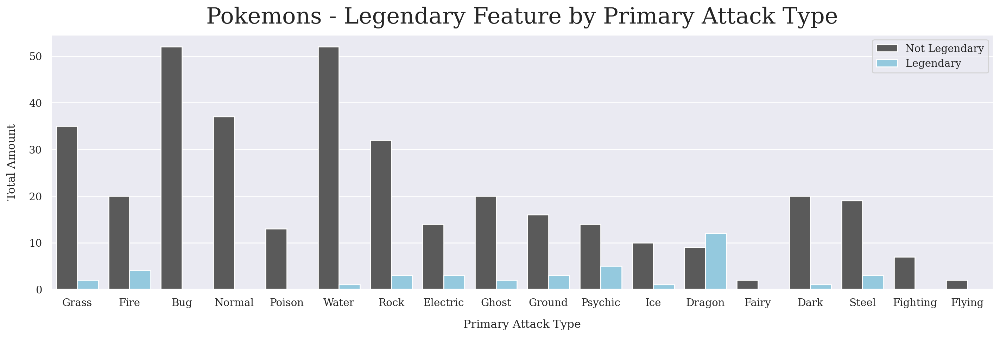

In [18]:
plt.figure(figsize=(18,5), dpi=192);
ax = sns.countplot(data=df_vis, x="Type 1", hue="Legendary")
plt.xlabel("Primary Attack Type", labelpad=12)
plt.ylabel("Total Amount", labelpad=12)
plt.legend(labels=["Not Legendary", "Legendary"], loc="upper right")
plt.title("Pokemons - Legendary Feature by Primary Attack Type", fontdict={"fontsize": 24}, pad=12);

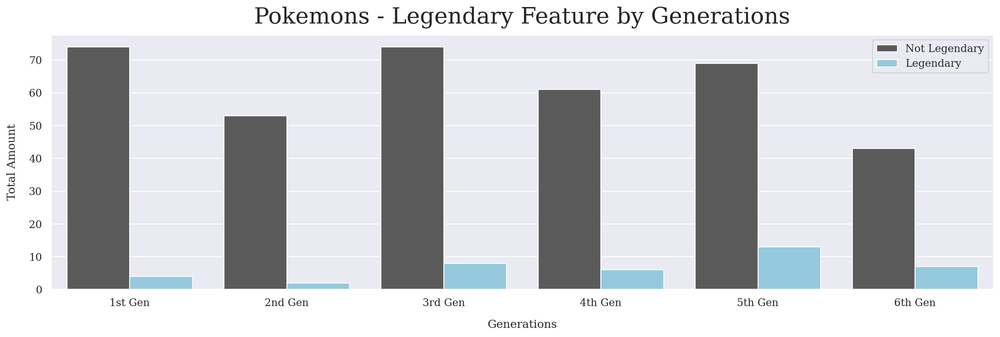

In [19]:
plt.figure(figsize=(18,5), dpi=192);
ax = sns.countplot(data=df_vis, x="Generation", hue="Legendary")
ax.set_xticklabels(["1st Gen", "2nd Gen", "3rd Gen", "4th Gen", "5th Gen", "6th Gen"])
plt.xlabel("Generations", labelpad=12)
plt.ylabel("Total Amount", labelpad=12)
plt.legend(labels=["Not Legendary", "Legendary"], loc="upper right")
plt.title("Pokemons - Legendary Feature by Generations", fontdict={"fontsize": 24}, pad=12);

### ***Pie Charts***

In [20]:
def pie_chart(x, data, labels=None, title=None, shadow=False, explode=None, pad=None):
    count = []
    perc_list = []
    for i in data[x].value_counts():
        count.append(i)
    count_arr = np.array([count])
    for i in count:
        perc_list.append(int(round(i / count_arr.sum(), 2) * 100))
    fig, ax = plt.subplots(figsize=(18,5), dpi=192)
    ax.pie(count, labels=labels, labeldistance=1.2, autopct='%1.1f%%', 
           explode=explode, shadow=shadow, textprops=dict(fontsize=16))
    ax.axis('equal')
    ax.set_title(title, fontdict=dict(fontsize=24), pad=pad)
    plt.show()

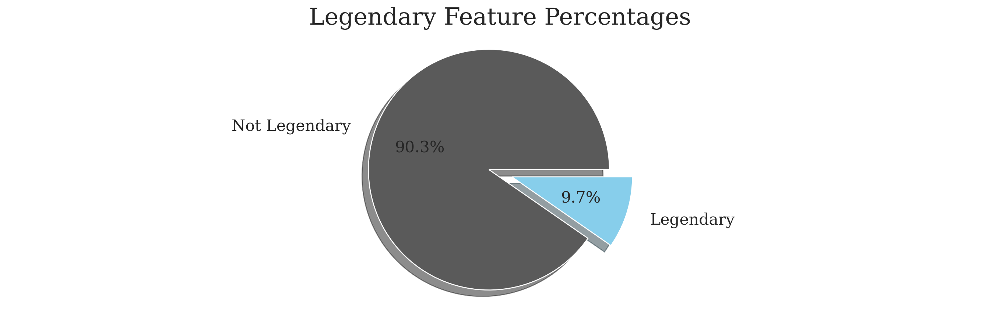

In [21]:
leg_labels = ["Not Legendary", "Legendary"]
leg_explode = [0.2, 0]
leg_title = "Legendary Feature Percentages"
pie_chart("Legendary", df_vis, title=leg_title, labels=leg_labels, explode=leg_explode, pad=12, shadow=True)

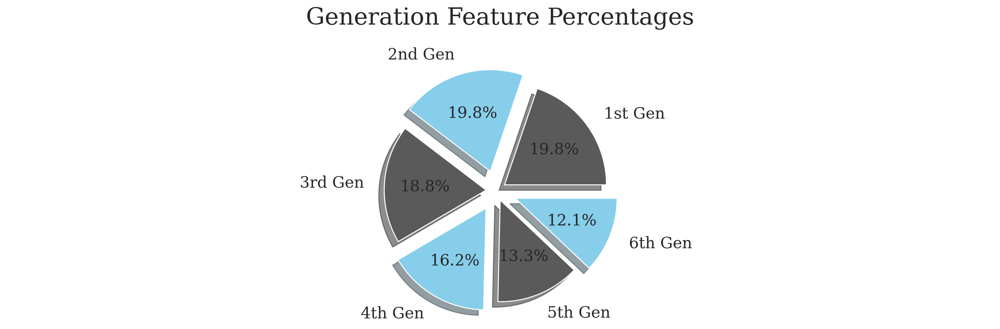

In [22]:
gen_labels = ["1st Gen", "2nd Gen", "3rd Gen", "4th Gen", "5th Gen", "6th Gen"]
gen_explode = [0.1, 0.2, 0.1, 0.2, 0.1, 0.2]
gen_title = "Generation Feature Percentages"
pie_chart("Generation", df_vis, title=gen_title, labels=gen_labels, explode=gen_explode, pad=32, shadow=True)

### ***Doughnut Charts***

In [23]:
def doughnut_chart(x, data, labels=None, title=None, shadow=False, explode=None, pad=None):
    count = []
    perc_list = []
    for i in data[x].value_counts():
        count.append(i)
    count_arr = np.array([count])
    for i in count:
        perc_list.append(int(round(i / count_arr.sum(), 2) * 100))
    fig, ax = plt.subplots(figsize=(18,5), dpi=192)
    ax.pie(count, labels=labels, labeldistance=1.2, autopct='%1.1f%%', 
           explode=explode, shadow=shadow, textprops=dict(fontsize=16), 
           wedgeprops={"width":0.4}, pctdistance=0.35)
    ax.axis('equal')
    ax.set_title(title, fontdict=dict(fontsize=24), pad=pad)
    plt.show()

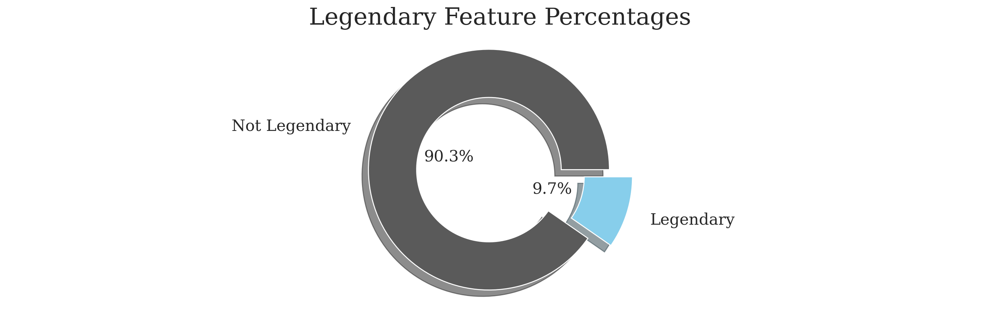

In [24]:
leg_labels = ["Not Legendary", "Legendary"]
leg_explode = [0.2, 0]
leg_title = "Legendary Feature Percentages"
doughnut_chart("Legendary", df_vis, title=leg_title, labels=leg_labels, explode=leg_explode, pad=12, shadow=True)

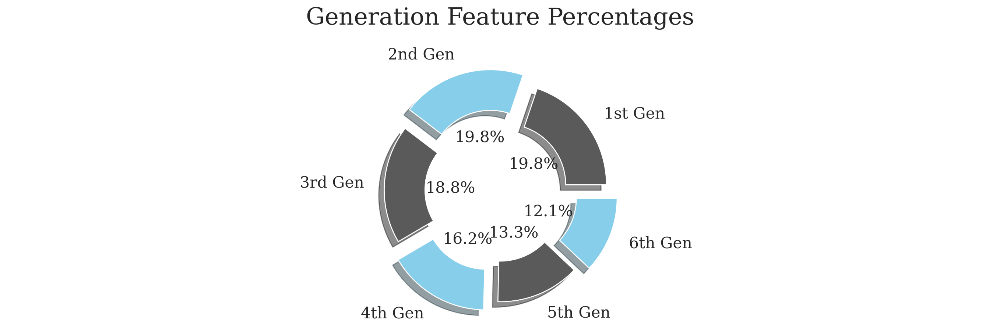

In [25]:
gen_labels = ["1st Gen", "2nd Gen", "3rd Gen", "4th Gen", "5th Gen", "6th Gen"]
gen_explode = [0.1, 0.2, 0.1, 0.2, 0.1, 0.2]
gen_title = "Generation Feature Percentages"
doughnut_chart("Generation", df_vis, title=gen_title, labels=gen_labels, explode=gen_explode, pad=32, shadow=True)

### ***Stacked Bar Charts***

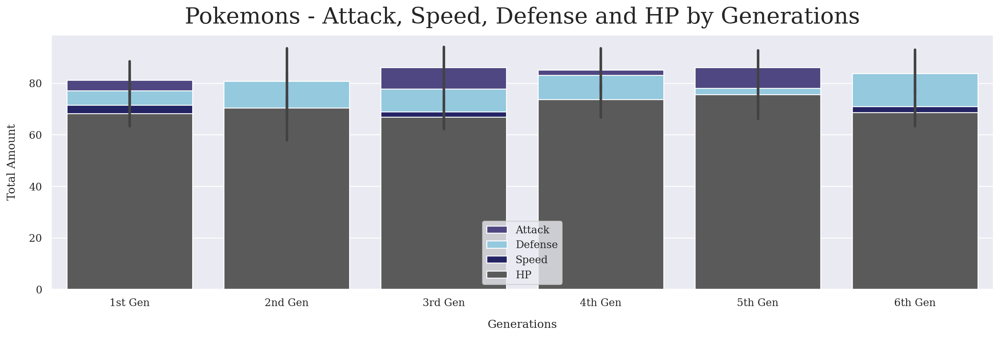

In [26]:
plt.figure(figsize=(18, 5), dpi=192)
ax = sns.barplot(x="Generation", y="Attack", data=df_vis, label="Attack", color="darkslateblue");
ax = sns.barplot(x="Generation", y="Defense", data=df_vis, label="Defense", palette=["#87CEEB"]);
ax = sns.barplot(x="Generation", y="Speed", data=df_vis, label="Speed", color="midnightblue");
ax = sns.barplot(x="Generation", y="HP", data=df_vis, label="HP", palette=["#5A5A5A"]);
ax.set_xticklabels(["1st Gen", "2nd Gen", "3rd Gen", "4th Gen", "5th Gen", "6th Gen"]);
plt.xlabel("Generations", labelpad=12)
plt.ylabel("Total Amount", labelpad=12)
plt.legend(loc="lower center")
plt.title("Pokemons - Attack, Speed, Defense and HP by Generations", fontdict={"fontsize": 24}, pad=12);

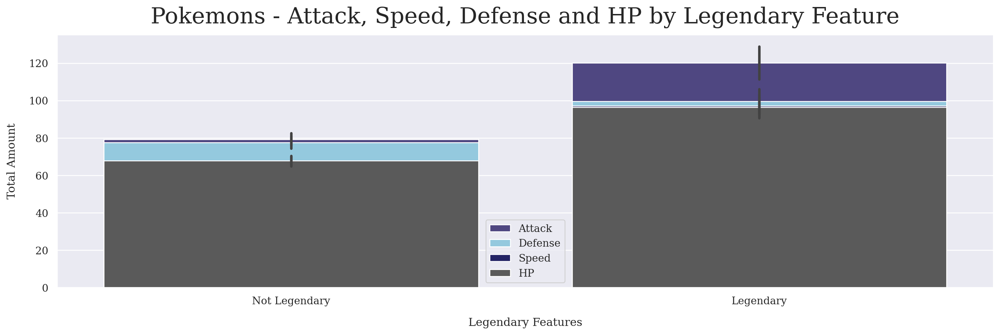

In [27]:
plt.figure(figsize=(18, 5), dpi=192)
ax = sns.barplot(x="Legendary", y="Attack", data=df_vis, label="Attack", color="darkslateblue");
ax = sns.barplot(x="Legendary", y="Defense", data=df_vis, label="Defense", palette=["#87CEEB"]);
ax = sns.barplot(x="Legendary", y="Speed", data=df_vis, label="Speed", color="midnightblue");
ax = sns.barplot(x="Legendary", y="HP", data=df_vis, label="HP", palette=["#5A5A5A"]);
ax.set_xticklabels(["Not Legendary", "Legendary"]);
plt.xlabel("Legendary Features", labelpad=12)
plt.ylabel("Total Amount", labelpad=12)
plt.legend(loc="lower center")
plt.title("Pokemons - Attack, Speed, Defense and HP by Legendary Feature", fontdict={"fontsize": 24}, pad=12);

### ***Violin Graphs***

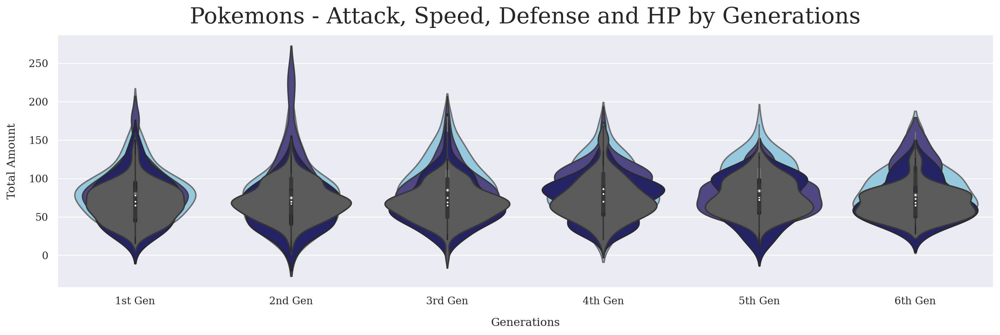

In [28]:
plt.figure(figsize=(18,5), dpi=192)
ax = sns.violinplot(x="Generation", y="Attack", data=df_vis, label="Attack", palette=["#87CEEB"]);
ax = sns.violinplot(x="Generation", y="Defense", data=df_vis, label="Defense", color="darkslateblue");
ax = sns.violinplot(x="Generation", y="Speed", data=df_vis, label="Speed", color="midnightblue");
ax = sns.violinplot(x="Generation", y="HP", data=df_vis, label="HP", palette=["#5A5A5A"]);
ax.set_xticklabels(["1st Gen", "2nd Gen", "3rd Gen", "4th Gen", "5th Gen", "6th Gen"]);
plt.xlabel("Generations", labelpad=12)
plt.ylabel("Total Amount", labelpad=12)
plt.title("Pokemons - Attack, Speed, Defense and HP by Generations", fontdict={"fontsize": 24}, pad=12);

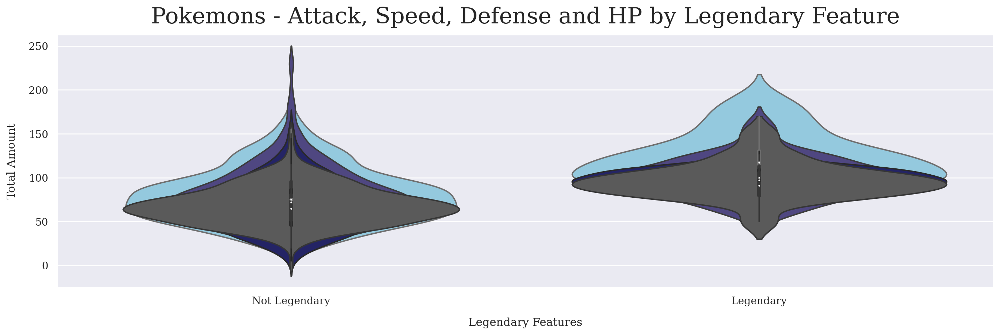

In [29]:
plt.figure(figsize=(18,5), dpi=192)
ax = sns.violinplot(x="Legendary", y="Attack", data=df_vis, palette=["#87CEEB"]);
ax = sns.violinplot(x="Legendary", y="Defense", data=df_vis, color="darkslateblue");
ax = sns.violinplot(x="Legendary", y="Speed", data=df_vis, color="midnightblue");
ax = sns.violinplot(x="Legendary", y="HP", data=df_vis,  palette=["#5A5A5A"]);
ax.set_xticklabels(["Not Legendary", "Legendary"]);
plt.xlabel("Legendary Features", labelpad=12)
plt.ylabel("Total Amount", labelpad=12)
plt.title("Pokemons - Attack, Speed, Defense and HP by Legendary Feature", fontdict={"fontsize": 24}, pad=12);

## ***Numerical Features***

### ***Pairwise Graphs***

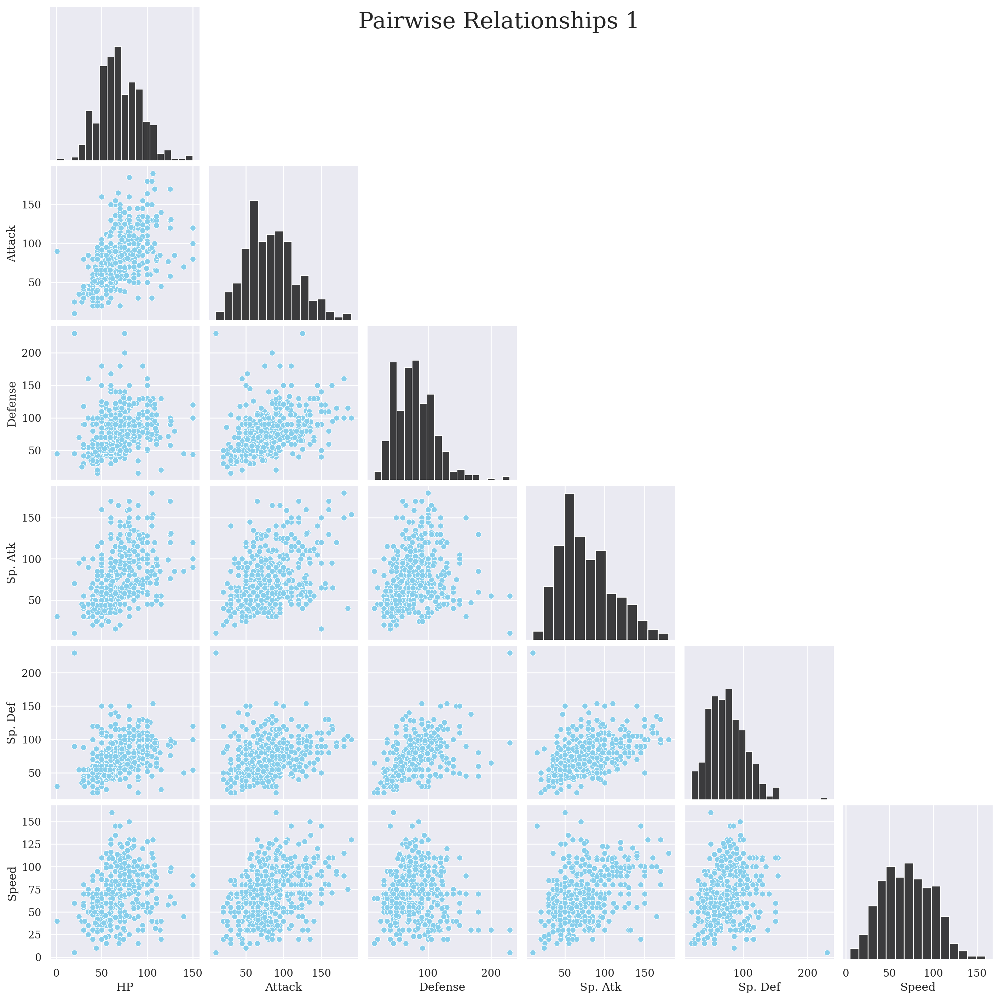

In [30]:
col = ["HP","Attack","Defense","Sp. Atk","Sp. Def","Speed"]
g = sns.pairplot(df_vis.loc[:,col], corner=True, plot_kws={"color":"skyblue"}, diag_kws={"color":"black"})
g.fig.figsize = (18, 5)
g.fig.dpi = 192
g.fig.suptitle("Pairwise Relationships 1", fontsize=24);

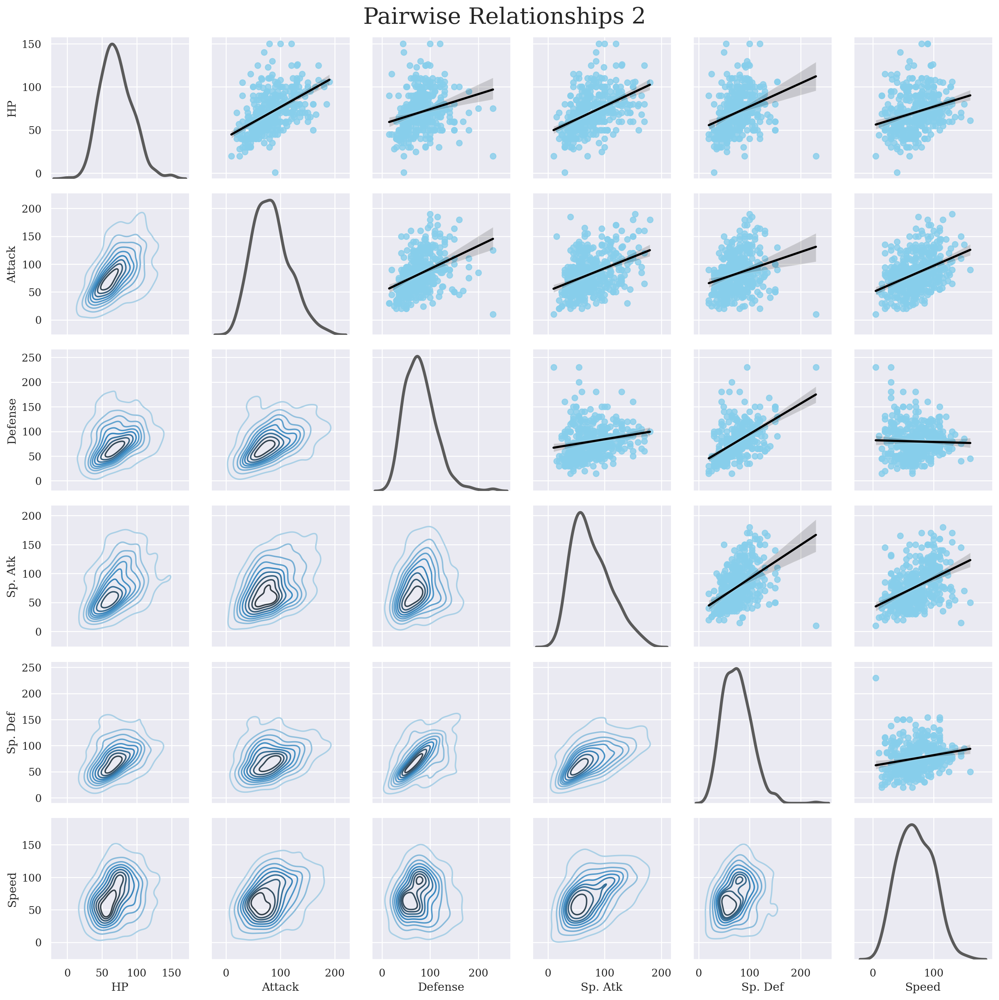

In [31]:
g = sns.PairGrid(df_vis.loc[:,col], diag_sharey=False)
g.map_lower(sns.kdeplot, cmap="Blues_d")
g.map_upper(sns.regplot, line_kws={"color":"black"}, scatter_kws={"color":"skyblue"})
g.map_diag(sns.kdeplot, lw=3);
g.fig.figsize = (18, 5)
g.fig.dpi = 192
g.fig.suptitle("Pairwise Relationships 2", fontsize=24);
g.fig.subplots_adjust(top=0.95)

### ***Pearson Correlation Heatmap***

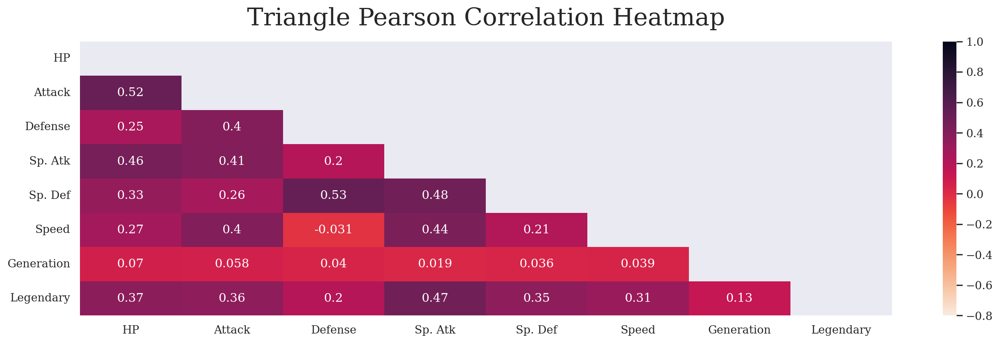

In [32]:
# 0.26 - 0.49 arası korelasyon (zayıf korelasyon) sayısı yüksek.

plt.figure(figsize=(18, 5), dpi=192)
mask = np.triu(np.ones_like(df_vis.corr(), dtype=np.bool))
heatmap = sns.heatmap(df_vis.corr(), mask=mask, vmin=-0.8, vmax=1, annot=True, cmap=sns.color_palette("rocket_r", as_cmap=True))
heatmap.set_title("Triangle Pearson Correlation Heatmap", fontdict={"fontsize": 24}, pad=16);

### ***Regression Plots***

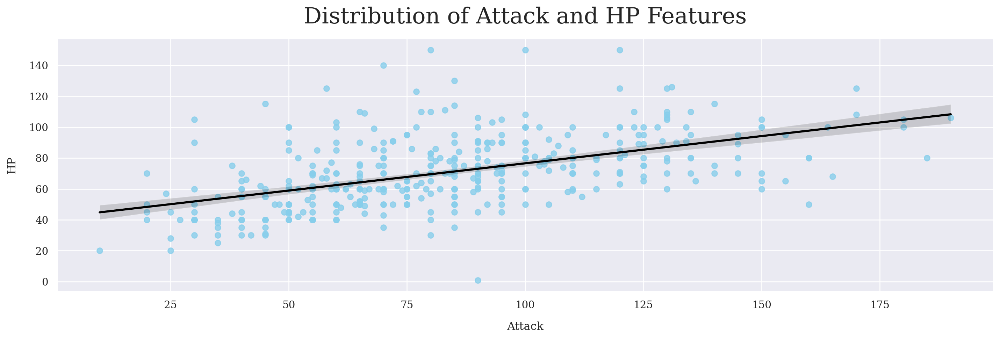

In [33]:
plt.figure(figsize=(18,5), dpi=192)
ax = sns.regplot(x="Attack", y="HP", data=df_vis, line_kws={"color":"black"}, scatter_kws={"color":"skyblue"})
plt.xlabel("Attack", labelpad=12)
plt.ylabel("HP", labelpad=12)
plt.title("Distribution of Attack and HP Features", fontdict={"fontsize": 24}, pad=16);

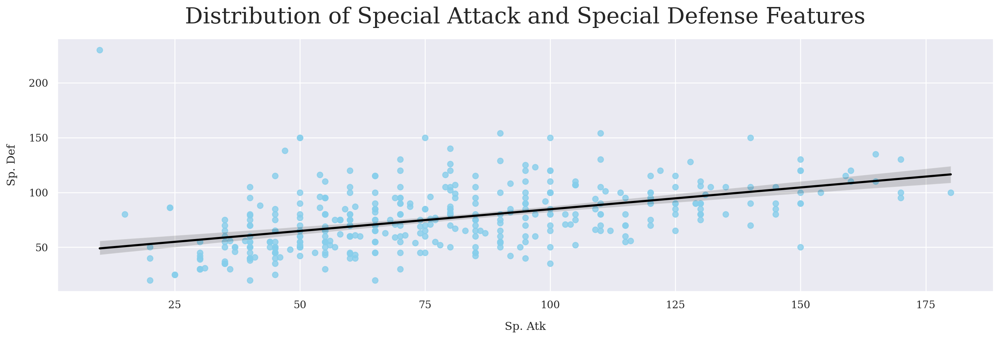

In [34]:
plt.figure(figsize=(18,5), dpi=192)
ax = sns.regplot(x="Sp. Atk", y="Sp. Def", data=df_vis, line_kws={"color":"black"}, scatter_kws={"color":"skyblue"})
plt.xlabel("Sp. Atk", labelpad=12)
plt.ylabel("Sp. Def", labelpad=12)
plt.title("Distribution of Special Attack and Special Defense Features", fontdict={"fontsize": 24}, pad=16);

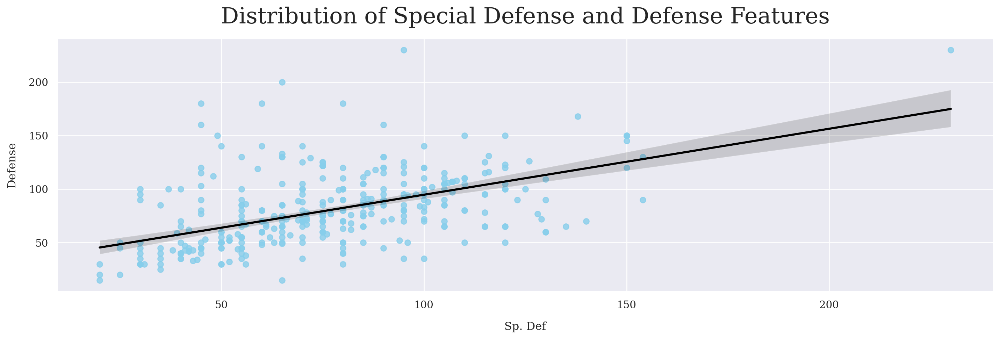

In [35]:
plt.figure(figsize=(18,5), dpi=192)
ax = sns.regplot(x="Sp. Def", y="Defense", data=df_vis, line_kws={"color":"black"}, scatter_kws={"color":"skyblue"})
plt.xlabel("Sp. Def", labelpad=12)
plt.ylabel("Defense", labelpad=12)
plt.title("Distribution of Special Defense and Defense Features", fontdict={"fontsize": 24}, pad=16);

### ***Box Plots***

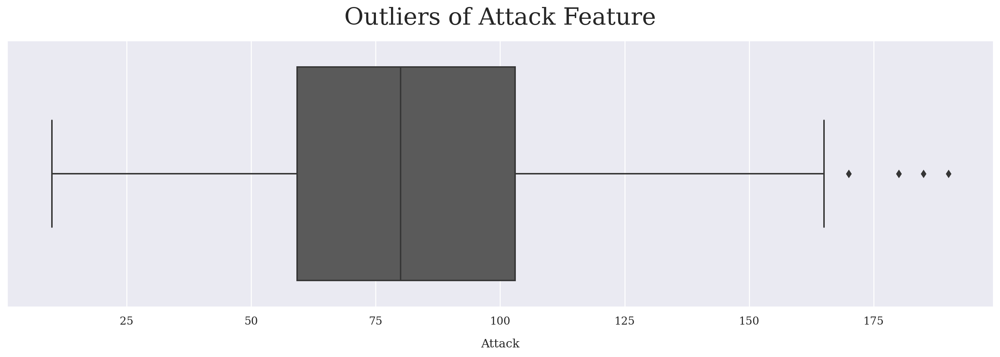

In [36]:
plt.figure(figsize=(18,5), dpi=192)
ax = sns.boxplot(x="Attack", data=df_vis);
plt.xlabel("Attack", labelpad=12);
plt.title("Outliers of Attack Feature", fontdict={"fontsize": 24}, pad=16);

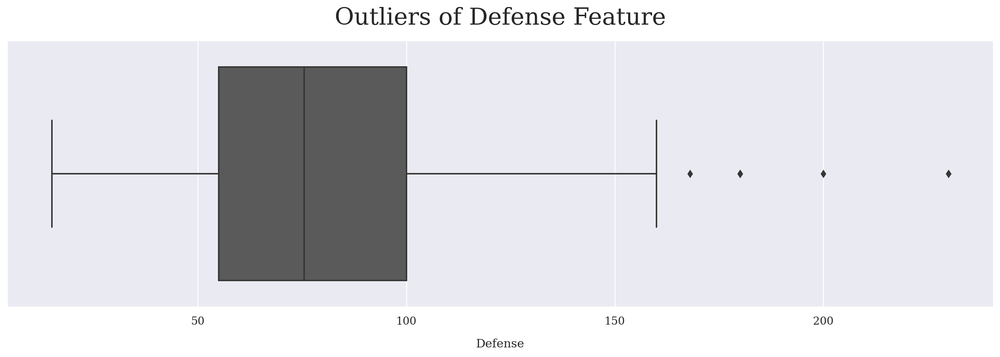

In [37]:
plt.figure(figsize=(18,5), dpi=192)
ax = sns.boxplot(x="Defense", data=df_vis);
plt.xlabel("Defense", labelpad=12);
plt.title("Outliers of Defense Feature", fontdict={"fontsize": 24}, pad=16);

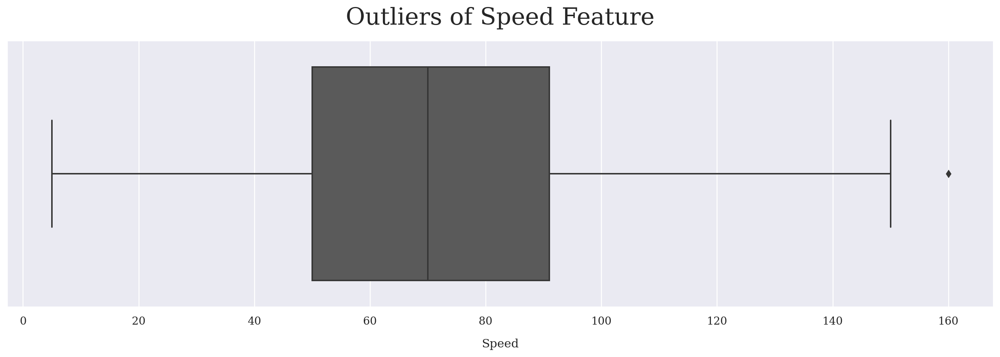

In [38]:
plt.figure(figsize=(18,5), dpi=192)
ax = sns.boxplot(x="Speed", data=df_vis);
plt.xlabel("Speed", labelpad=12);
plt.title("Outliers of Speed Feature", fontdict={"fontsize": 24}, pad=16);

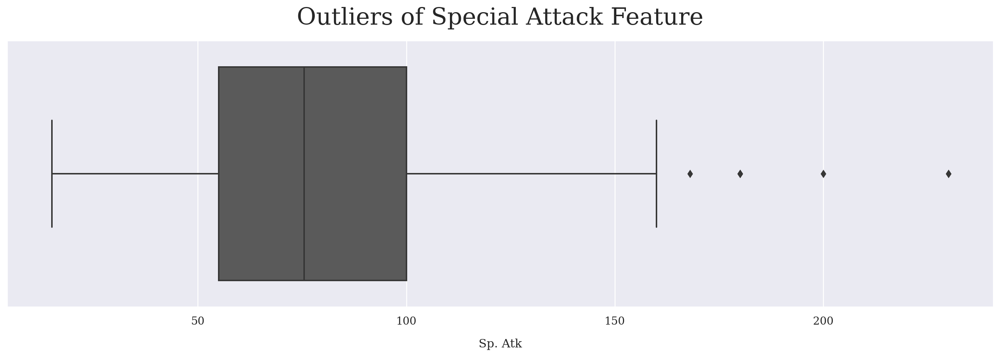

In [39]:
plt.figure(figsize=(18,5), dpi=192)
ax = sns.boxplot(x="Defense", data=df_vis);
plt.xlabel("Sp. Atk", labelpad=12);
plt.title("Outliers of Special Attack Feature", fontdict={"fontsize": 24}, pad=16);

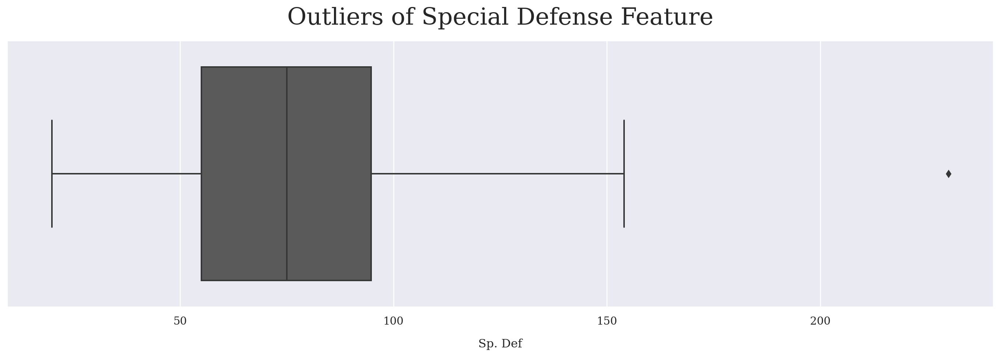

In [40]:
plt.figure(figsize=(18,5), dpi=192)
ax = sns.boxplot(x="Sp. Def", data=df_vis);
plt.xlabel("Sp. Def", labelpad=12);
plt.title("Outliers of Special Defense Feature", fontdict={"fontsize": 24}, pad=16);

### ***HoloViews***

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
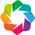

:Layout
   .Table.I  :Table   [Name,Type 1,Attack]
   .Table.II :Table   [Name,Type 1,Defense]

In [41]:
at_ = data.sort_values("Attack", ascending=False)[["Name","Type 1","Attack"]].head(10)
def_ = data.sort_values("Defense", ascending=False)[["Name","Type 1","Defense"]].head(10)
hv.extension("bokeh")
def_ = hv.Table(def_)
at_ = hv.Table(at_)
at_ + def_

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
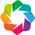

:Layout
   .Table.I  :Table   [Name,Type 1,Sp. Atk]
   .Table.II :Table   [Name,Type 1,Sp. Def]

In [42]:
sp_def = data.sort_values("Sp. Def", ascending=False)[["Name","Type 1","Sp. Def"]].head(10)
sp_att = data.sort_values("Sp. Atk", ascending=False)[["Name","Type 1","Sp. Atk"]].head(10)
hv.extension("bokeh")
sp_def = hv.Table(sp_def)
sp_att = hv.Table(sp_att)
sp_att + sp_def

# ***Feature Engineering***

In [43]:
style_df(combat_data.head())

,First_pokemon,Second_pokemon,Winner
0,266,298,298
1,702,701,701
2,191,668,668
3,237,683,683
4,151,231,151


In [44]:
%%time
df["Battles_Count"] = 0
for index, row in combat_data.iterrows():
    first_pokemon = row['First_pokemon']
    second_pokemon = row['Second_pokemon']
    df.loc[df['#'] == first_pokemon, 'Battles_Count'] += 1
    df.loc[df['#'] == second_pokemon, 'Battles_Count'] += 1

CPU times: user 1min 40s, sys: 67.1 ms, total: 1min 40s
Wall time: 1min 40s


In [45]:
%%time
df["Win_Count"] = 0
for index, row in combat_data.iterrows():
    winner = row['Winner']
    df.loc[df['#'] == winner, 'Win_Count'] += 1

CPU times: user 51.5 s, sys: 8.44 ms, total: 51.5 s
Wall time: 51.5 s


In [46]:
df['Win_Percentage'] = (df['Win_Count'] / df['Battles_Count']) * 100
df['Win_Percentage'] = df['Win_Percentage'].apply(lambda x: 0 if np.isnan(x) else x)

In [47]:
df = df.sort_values(by='#')
df = df.reset_index(drop=True)

In [48]:
style_df(df.head())

,#,Name,Type 1,Type 2,HP,Attack,Defense,Sp. Atk,Sp. Def,Speed,Generation,Legendary,Battles_Count,Win_Count,Win_Percentage
0,1,Bulbasaur,Grass,Poison,45,49,49,65,65,45,1,False,133,37,27.819549
1,2,Ivysaur,Grass,Poison,60,62,63,80,80,60,1,False,121,46,38.016529
2,3,Venusaur,Grass,Poison,80,82,83,100,100,80,1,False,132,89,67.424242
3,4,Mega Venusaur,Grass,Poison,80,100,123,122,120,80,1,False,125,70,56.000000
4,5,Charmander,Fire,nan,39,52,43,60,50,65,1,False,112,55,49.107143


## ***Split Columns***

In [49]:
def split_columns(data):
    cat_cols = []
    num_cols = []
    for col in data.columns:
        if data[col].dtype == "object" or data[col].dtype == "bool" or ((data[col].dtype == "int64") and (data[col].value_counts().count() <= 10)):
            cat_cols.append(col)
        if  data[col].dtype == "float" or ((data[col].dtype == "int64") and (data[col].value_counts().count() > 10)):  # Non-Binary
            num_cols.append(col)

    return data[num_cols], data[cat_cols]

num_cols, cat_cols = split_columns(df)
style_df(cat_cols.head())

,Name,Type 1,Type 2,Generation,Legendary
0,Bulbasaur,Grass,Poison,1,False
1,Ivysaur,Grass,Poison,1,False
2,Venusaur,Grass,Poison,1,False
3,Mega Venusaur,Grass,Poison,1,False
4,Charmander,Fire,nan,1,False


# ***Data Preprocessing***

In [50]:
style_df(combat_data.head())

,First_pokemon,Second_pokemon,Winner
0,266,298,298
1,702,701,701
2,191,668,668
3,237,683,683
4,151,231,151


In [51]:
style_df(test_data.head())

,First_pokemon,Second_pokemon
0,129,117
1,660,211
2,706,115
3,195,618
4,27,656


In [52]:
style_df(df.head())

,#,Name,Type 1,Type 2,HP,Attack,Defense,Sp. Atk,Sp. Def,Speed,Generation,Legendary,Battles_Count,Win_Count,Win_Percentage
0,1,Bulbasaur,Grass,Poison,45,49,49,65,65,45,1,False,133,37,27.819549
1,2,Ivysaur,Grass,Poison,60,62,63,80,80,60,1,False,121,46,38.016529
2,3,Venusaur,Grass,Poison,80,82,83,100,100,80,1,False,132,89,67.424242
3,4,Mega Venusaur,Grass,Poison,80,100,123,122,120,80,1,False,125,70,56.000000
4,5,Charmander,Fire,nan,39,52,43,60,50,65,1,False,112,55,49.107143


## ***Categorical Columns***

### ___"Type 1" Column___

In [53]:
df["Type 1"].value_counts()

Water       112
Normal       98
Grass        70
Bug          69
Psychic      57
Fire         52
Electric     44
Rock         44
Dragon       32
Ground       32
Ghost        32
Dark         31
Poison       28
Steel        27
Fighting     27
Ice          24
Fairy        17
Flying        4
Name: Type 1, dtype: int64

In [54]:
map_new = {"Water":"0", "Normal":"1", "Grass":"2", "Bug":"3", "Psychic":"4", "Fire":"5", "Electric":"6",
           "Rock":"7", "Dragon":"8", "Ground":"9", "Ghost":"10", "Dark":"11", "Poison":"12", "Steel":"13",
           "Fighting":"14", "Ice":"15", "Fairy":"16", "Flying":"17"}

df["Type 1"] = df["Type 1"].map(map_new)

In [55]:
df.rename(columns={"Type 1":"Type_1"}, inplace=True)

In [56]:
style_df(df.head())

,#,Name,Type_1,Type 2,HP,Attack,Defense,Sp. Atk,Sp. Def,Speed,Generation,Legendary,Battles_Count,Win_Count,Win_Percentage
0,1,Bulbasaur,2,Poison,45,49,49,65,65,45,1,False,133,37,27.819549
1,2,Ivysaur,2,Poison,60,62,63,80,80,60,1,False,121,46,38.016529
2,3,Venusaur,2,Poison,80,82,83,100,100,80,1,False,132,89,67.424242
3,4,Mega Venusaur,2,Poison,80,100,123,122,120,80,1,False,125,70,56.000000
4,5,Charmander,5,nan,39,52,43,60,50,65,1,False,112,55,49.107143


In [57]:
df["Type_1"] = df["Type_1"].astype("category")
df["Type_1"].dtype

CategoricalDtype(categories=['0', '1', '10', '11', '12', '13', '14', '15', '16', '17',
                  '2', '3', '4', '5', '6', '7', '8', '9'],
, ordered=False)

### ___"Type 2" Column___

In [58]:
df["Type 2"].value_counts()

Flying      97
Ground      35
Poison      34
Psychic     33
Fighting    26
Grass       25
Fairy       23
Steel       22
Dark        20
Dragon      18
Water       14
Ghost       14
Ice         14
Rock        14
Fire        12
Electric     6
Normal       4
Bug          3
Name: Type 2, dtype: int64

In [59]:
map_new = {"Water":"0", "Normal":"1", "Grass":"2", "Bug":"3", "Psychic":"4", "Fire":"5", "Electric":"6",
           "Rock":"7", "Dragon":"8", "Ground":"9", "Ghost":"10", "Dark":"11", "Poison":"12", "Steel":"13", 
           "Fighting":"14", "Ice":"15", "Fairy":"16", "Flying":"17"}

df["Type 2"] = df["Type 2"].map(map_new)

In [60]:
df.rename(columns={"Type 2":"Type_2"}, inplace=True)

In [61]:
style_df(df.head())

,#,Name,Type_1,Type_2,HP,Attack,Defense,Sp. Atk,Sp. Def,Speed,Generation,Legendary,Battles_Count,Win_Count,Win_Percentage
0,1,Bulbasaur,2,12,45,49,49,65,65,45,1,False,133,37,27.819549
1,2,Ivysaur,2,12,60,62,63,80,80,60,1,False,121,46,38.016529
2,3,Venusaur,2,12,80,82,83,100,100,80,1,False,132,89,67.424242
3,4,Mega Venusaur,2,12,80,100,123,122,120,80,1,False,125,70,56.000000
4,5,Charmander,5,nan,39,52,43,60,50,65,1,False,112,55,49.107143


In [62]:
df["Type_2"] = df["Type_2"].astype("category")
df["Type_2"].dtype

CategoricalDtype(categories=['0', '1', '10', '11', '12', '13', '14', '15', '16', '17',
                  '2', '3', '4', '5', '6', '7', '8', '9'],
, ordered=False)

### ___"Generation" Column___

In [63]:
df["Generation"].value_counts()

1    166
5    165
3    160
4    121
2    106
6     82
Name: Generation, dtype: int64

In [64]:
from sklearn.preprocessing import LabelEncoder
label_encoder = LabelEncoder()
df["Generation"] = label_encoder.fit_transform(df["Generation"].astype(str))

In [65]:
style_df(df.head())

,#,Name,Type_1,Type_2,HP,Attack,Defense,Sp. Atk,Sp. Def,Speed,Generation,Legendary,Battles_Count,Win_Count,Win_Percentage
0,1,Bulbasaur,2,12,45,49,49,65,65,45,0,False,133,37,27.819549
1,2,Ivysaur,2,12,60,62,63,80,80,60,0,False,121,46,38.016529
2,3,Venusaur,2,12,80,82,83,100,100,80,0,False,132,89,67.424242
3,4,Mega Venusaur,2,12,80,100,123,122,120,80,0,False,125,70,56.000000
4,5,Charmander,5,nan,39,52,43,60,50,65,0,False,112,55,49.107143


In [66]:
df["Generation"] = df["Generation"].astype("category")
df["Generation"].dtype

CategoricalDtype(categories=[0, 1, 2, 3, 4, 5], ordered=False)

### ___"Legendary" Column___

In [67]:
df["Legendary"].value_counts()

False    735
True      65
Name: Legendary, dtype: int64

In [68]:
from sklearn.preprocessing import LabelEncoder
label_encoder = LabelEncoder()
df["Legendary"] = label_encoder.fit_transform(df["Legendary"].astype(str))

In [69]:
style_df(df.head())

,#,Name,Type_1,Type_2,HP,Attack,Defense,Sp. Atk,Sp. Def,Speed,Generation,Legendary,Battles_Count,Win_Count,Win_Percentage
0,1,Bulbasaur,2,12,45,49,49,65,65,45,0,0,133,37,27.819549
1,2,Ivysaur,2,12,60,62,63,80,80,60,0,0,121,46,38.016529
2,3,Venusaur,2,12,80,82,83,100,100,80,0,0,132,89,67.424242
3,4,Mega Venusaur,2,12,80,100,123,122,120,80,0,0,125,70,56.000000
4,5,Charmander,5,nan,39,52,43,60,50,65,0,0,112,55,49.107143


In [70]:
df["Legendary"] = df["Legendary"].astype("category")
df["Legendary"].dtype

CategoricalDtype(categories=[0, 1], ordered=False)

## ***Numerical Columns***

### ***Sp. Atk Column***

In [71]:
df.rename(columns={"Sp. Atk":"Sp_Atk"}, inplace=True)

### ***Sp. Def Column***

In [72]:
df.rename(columns={"Sp. Def":"Sp_Def"}, inplace=True)

### ___"Id" = "#"___

In [73]:
df.rename(columns = {"#":"Id"}, inplace=True)

In [74]:
style_df(df.head())

,Id,Name,Type_1,Type_2,HP,Attack,Defense,Sp_Atk,Sp_Def,Speed,Generation,Legendary,Battles_Count,Win_Count,Win_Percentage
0,1,Bulbasaur,2,12,45,49,49,65,65,45,0,0,133,37,27.819549
1,2,Ivysaur,2,12,60,62,63,80,80,60,0,0,121,46,38.016529
2,3,Venusaur,2,12,80,82,83,100,100,80,0,0,132,89,67.424242
3,4,Mega Venusaur,2,12,80,100,123,122,120,80,0,0,125,70,56.000000
4,5,Charmander,5,nan,39,52,43,60,50,65,0,0,112,55,49.107143


### ___"Name" Column___

In [75]:
df.drop("Name",axis=1,inplace=True)
style_df(df.head())

,Id,Type_1,Type_2,HP,Attack,Defense,Sp_Atk,Sp_Def,Speed,Generation,Legendary,Battles_Count,Win_Count,Win_Percentage
0,1,2,12,45,49,49,65,65,45,0,0,133,37,27.819549
1,2,2,12,60,62,63,80,80,60,0,0,121,46,38.016529
2,3,2,12,80,82,83,100,100,80,0,0,132,89,67.424242
3,4,2,12,80,100,123,122,120,80,0,0,125,70,56.000000
4,5,5,nan,39,52,43,60,50,65,0,0,112,55,49.107143


## ***Missing Values***

In [76]:
df.isnull().sum()

Id                  0
Type_1              0
Type_2            386
HP                  0
Attack              0
Defense             0
Sp_Atk              0
Sp_Def              0
Speed               0
Generation          0
Legendary           0
Battles_Count       0
Win_Count           0
Win_Percentage      0
dtype: int64

In [77]:
from sklearn.impute import KNNImputer
imputer = KNNImputer(n_neighbors = 2)
df_imp = imputer.fit_transform(df)
df = pd.DataFrame(df_imp, columns = df.columns)

In [78]:
df.isnull().sum()

Id                0
Type_1            0
Type_2            0
HP                0
Attack            0
Defense           0
Sp_Atk            0
Sp_Def            0
Speed             0
Generation        0
Legendary         0
Battles_Count     0
Win_Count         0
Win_Percentage    0
dtype: int64

In [79]:
for col in df.columns:
    if col == "Win_Percentage":
        continue
    else:
        df[col] = df[col].astype("int")

In [80]:
df.dtypes

Id                  int64
Type_1              int64
Type_2              int64
HP                  int64
Attack              int64
Defense             int64
Sp_Atk              int64
Sp_Def              int64
Speed               int64
Generation          int64
Legendary           int64
Battles_Count       int64
Win_Count           int64
Win_Percentage    float64
dtype: object

## ***Categorical Features List***

In [81]:
cat_cols.rename(columns={"Type 1":"Type_1", "Type 2":"Type_2"}, inplace=True)

In [82]:
cat_features = [x for x in cat_cols.columns if x != "Name"]

In [83]:
cat_features

['Type_1', 'Type_2', 'Generation', 'Legendary']

In [84]:
for col in cat_features:
    df[col] = df[col].astype("category")

In [85]:
df.dtypes

Id                   int64
Type_1            category
Type_2            category
HP                   int64
Attack               int64
Defense              int64
Sp_Atk               int64
Sp_Def               int64
Speed                int64
Generation        category
Legendary         category
Battles_Count        int64
Win_Count            int64
Win_Percentage     float64
dtype: object

In [86]:
df.set_index("Id", inplace=True)

In [87]:
style_df(df.head(10))

,Type_1,Type_2,HP,Attack,Defense,Sp_Atk,Sp_Def,Speed,Generation,Legendary,Battles_Count,Win_Count,Win_Percentage
Id,,,,,,,,,,,,,
1,2,12,45,49,49,65,65,45,0,0,133,37,27.819549
2,2,12,60,62,63,80,80,60,0,0,121,46,38.016529
3,2,12,80,82,83,100,100,80,0,0,132,89,67.424242
4,2,12,80,100,123,122,120,80,0,0,125,70,56.000000
5,5,17,39,52,43,60,50,65,0,0,112,55,49.107143
6,5,14,58,64,58,80,65,80,0,0,118,64,54.237288
7,5,17,78,84,78,109,85,100,0,0,133,115,86.466165
8,5,8,78,130,111,130,85,100,0,0,139,119,85.611511
9,5,17,78,104,78,159,115,100,0,0,135,114,84.444444


In [88]:
style_df(df.tail(10))

,Type_1,Type_2,HP,Attack,Defense,Sp_Atk,Sp_Def,Speed,Generation,Legendary,Battles_Count,Win_Count,Win_Percentage
Id,,,,,,,,,,,,,
791,17,8,40,30,35,45,40,55,5,0,127,40,31.496063
792,17,8,85,70,80,97,80,123,5,0,115,107,93.043478
793,16,8,126,131,95,131,98,99,5,1,129,107,82.945736
794,11,17,126,131,95,131,98,99,5,1,137,111,81.021898
795,8,9,108,100,121,81,95,95,5,1,107,80,74.766355
796,7,16,50,100,150,100,150,50,5,1,105,39,37.142857
797,7,16,50,160,110,160,110,110,5,1,131,116,88.549618
798,4,10,80,110,60,150,130,70,5,1,119,60,50.420168
799,4,11,80,160,60,170,130,80,5,1,144,89,61.805556


## ***Test Train Split***

In [89]:
y = df["Win_Percentage"]
X = df.drop(["Win_Percentage", "Battles_Count", "Win_Count"], axis=1)

X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.20, random_state=1)

X_train, X_valid, y_train, y_valid = train_test_split(
    X_train, y_train, test_size=0.20, random_state=1)

print(X_train.shape)
print(X_valid.shape)
print(X_test.shape)

(512, 10)
(128, 10)
(160, 10)


# ***Machine Learning Models***

In [90]:
from sklearn.linear_model import LinearRegression, Ridge, Lasso, ElasticNet
from sklearn.neighbors import KNeighborsRegressor
from sklearn.svm import SVR
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from xgboost import XGBRegressor
from lightgbm import LGBMRegressor

models = []

models.append(('Regression', LinearRegression()))
models.append(('Ridge', Ridge()))
models.append(('Lasso', Lasso()))
models.append(('ElasticNet', ElasticNet()))
models.append(('KNN', KNeighborsRegressor()))
models.append(('SVR', SVR()))
models.append(('CART', DecisionTreeRegressor()))
models.append(('RF', RandomForestRegressor()))
models.append(('GBM', GradientBoostingRegressor()))
#models.append(("XGBoost", XGBRegressor()))
models.append(("LightGBM", LGBMRegressor()))

for name, model in models:
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    mse = mean_squared_error(y_test, y_pred)
    rmse = np.sqrt(mse)
    print(name, "MSE Score: {:.8f}".format(mse), "RMSE Score: {:.8f}".format(rmse))

Regression MSE Score: 98.50802198 RMSE Score: 9.92512075
Ridge MSE Score: 98.39561651 RMSE Score: 9.91945646
Lasso MSE Score: 96.68141357 RMSE Score: 9.83267072
ElasticNet MSE Score: 96.58773706 RMSE Score: 9.82790604
KNN MSE Score: 125.95149447 RMSE Score: 11.22281134
SVR MSE Score: 135.88486649 RMSE Score: 11.65696644
CART MSE Score: 149.81768507 RMSE Score: 12.24000348
RF MSE Score: 82.46036023 RMSE Score: 9.08076870
GBM MSE Score: 84.02761872 RMSE Score: 9.16665799
LightGBM MSE Score: 78.88985288 RMSE Score: 8.88199600


# ***LightGBM Dataset***

In [91]:
import lightgbm as lgb

ftr_name = df.drop(["Win_Percentage", "Battles_Count", "Win_Count"], axis=1).columns.to_list()

d_train = lgb.Dataset(X_train, label=y_train, feature_name=ftr_name,
                      categorical_feature=cat_features, free_raw_data=False)
d_eval = lgb.Dataset(X_valid, label=y_valid, feature_name=ftr_name,
                     categorical_feature=cat_features, reference=d_train,
                     free_raw_data=False)

params = {
    "objective": "regression",
    "metric": ["mse", "rmse"],
    "boosting_type": "gbdt",
    "num_leaves": 31,
    "learning_rate": 0.09,
    "deterministic" : True, # maybe slow down the running rate
    "force_row_wise": True, # row-wise computation, may be slower for bigger datas
    "feature_pre_filter": False,
    "verbosity": -1000,
    "seed": 31
}

evals_result={}
lgb_model = lgb.train(params,d_train,
                      valid_sets=d_eval,
                      num_boost_round=1000,
                      early_stopping_rounds=200,
                      evals_result=evals_result,
                      verbose_eval=False
                     )

In [92]:
lgb_pred = lgb_model.predict(X_test)
lgb_mse = mean_squared_error(y_test, lgb_pred)
lgb_rmse = np.sqrt(mean_squared_error(y_test, lgb_pred))
lgb_r2 = r2_score(y_test, lgb_pred)
print("MSE Score: {:.8f}".format(lgb_mse))
print("RMSE Score: {:.8f}".format(lgb_rmse))
print("R2 Score: {:.8f}".format(lgb_r2))

MSE Score: 81.20701060
RMSE Score: 9.01149325
R2 Score: 0.89474232


# ***Optuna Hyperparameter Searching***

In [93]:
import lightgbm as lgb
import optuna

ftr_name = df.drop(["Win_Percentage", "Battles_Count", "Win_Count"], axis=1).columns.to_list()

d_train = lgb.Dataset(X_train, label=y_train, feature_name=ftr_name,
                      categorical_feature=cat_features, free_raw_data=False)
d_eval = lgb.Dataset(X_valid, label=y_valid, feature_name=ftr_name,
                     categorical_feature=cat_features, reference=d_train,
                     free_raw_data=False)

def objective(trial):
    params = {
        "objective": "huber",
        "metric": ["mse", "rmse"],
        "boosting_type": trial.suggest_categorical("boosting_type", ["gbdt", "dart"]),
        "num_leaves": trial.suggest_int("num_leaves", 2, 200),
        "learning_rate": trial.suggest_loguniform("learning_rate", 0.001, 1.0),
        "max_depth": trial.suggest_int("max_depth", 1, 10),
        "min_child_samples": trial.suggest_int("min_child_samples", 5, 200),
        "subsample": trial.suggest_uniform("subsample", 0.1, 1.0),
        "subsample_freq": trial.suggest_int("subsample_freq", 0, 10),
        "feature_fraction": trial.suggest_uniform("feature_fraction", 0.5, 1.0),
        "alpha": trial.suggest_uniform("alpha", 0.5, 1.0),
        "lambda_l1": trial.suggest_loguniform("lambda_l1", 1e-8, 10.0),
        "lambda_l2": trial.suggest_loguniform("lambda_l2", 1e-8, 10.0),
        "feature_pre_filter": False,
        "deterministic" : True,
        "force_row_wise": True,
        "verbosity": -1000,
        "seed": 31
    }

    evals_result = {}
    model = lgb.train(params, d_train,
                      valid_sets=d_eval,
                      num_boost_round=1000,
                      early_stopping_rounds=200,
                      evals_result=evals_result,
                      verbose_eval=False
                     )
    return min(evals_result["valid_0"]["rmse"])

study = optuna.create_study()
study.optimize(objective, n_trials=100)

[I 2023-02-09 21:19:01,496] A new study created in memory with name: no-name-8238aa38-c47d-4942-868f-aa1cfe0d1f18
[I 2023-02-09 21:19:01,684] Trial 0 finished with value: 18.539303569494457 and parameters: {'boosting_type': 'gbdt', 'num_leaves': 166, 'learning_rate': 0.025849639161933387, 'max_depth': 6, 'min_child_samples': 155, 'subsample': 0.8943614166990773, 'subsample_freq': 7, 'feature_fraction': 0.8200884185808285, 'alpha': 0.6533054090516635, 'lambda_l1': 2.6166260814345674e-06, 'lambda_l2': 2.5091779670824085e-07}. Best is trial 0 with value: 18.539303569494457.
[I 2023-02-09 21:19:02,660] Trial 1 finished with value: 26.186356030495492 and parameters: {'boosting_type': 'dart', 'num_leaves': 160, 'learning_rate': 0.0404977354728748, 'max_depth': 1, 'min_child_samples': 84, 'subsample': 0.9204267137272156, 'subsample_freq': 1, 'feature_fraction': 0.5362480245236173, 'alpha': 0.7526803864343808, 'lambda_l1': 2.7995726958943748e-05, 'lambda_l2': 0.10507932129418796}. Best is tria

In [94]:
best_params = study.best_params
print("Best hyperparameters: ", best_params)

Best hyperparameters:  {'boosting_type': 'gbdt', 'num_leaves': 41, 'learning_rate': 0.49602924135893023, 'max_depth': 3, 'min_child_samples': 9, 'subsample': 0.3271226749019419, 'subsample_freq': 8, 'feature_fraction': 0.978309160055754, 'alpha': 0.5996290594436607, 'lambda_l1': 1.958755371043883e-07, 'lambda_l2': 3.5050928987092844e-05}


## ***Tuned LightGBM Model***

In [95]:
best_params["objective"] = "huber"
best_params["metric"] = ["mse", "rmse"]
best_params["feature_pre_filter"] = False
best_params["deterministic"] = True
best_params["force_row_wise"] = True
best_params["verbosity"] = -1000
best_params["seed"] = 31

best_model = lgb.train(best_params, d_train,
                      valid_sets = d_eval,
                      num_boost_round = 1000,
                      early_stopping_rounds = 200,
                      verbose_eval = False
                     )


In [96]:
best_preds = best_model.predict(X_test)
best_mse = mean_squared_error(y_test, best_preds)
best_rmse = np.sqrt(mean_squared_error(y_test, best_preds))
best_r2 = r2_score(y_test, best_preds)
print("MSE Score: {:.8f}".format(best_mse))
print("RMSE Score: {:.8f}".format(best_rmse))
print("R2 Score: {:.8f}".format(best_r2))

MSE Score: 74.93819041
RMSE Score: 8.65668472
R2 Score: 0.90286775


# ***Test Data Manipulation***

In [97]:
x_df = X.copy()
x_preds = best_model.predict(x_df)
x_mse = mean_squared_error(y, x_preds)
x_rmse = np.sqrt(mean_squared_error(y, x_preds))
x_r2 = r2_score(y, x_preds)
print("MSE Score: {:.8f}".format(x_mse))
print("RMSE Score: {:.8f}".format(x_rmse))
print("R2 Score: {:.8f}".format(x_r2))

MSE Score: 72.46736780
RMSE Score: 8.51277674
R2 Score: 0.89465416


In [98]:
x_df["True_Win_Percentage"] = y
x_df["Predicted_Win_Percentage"] = x_preds
x_df = x_df.reset_index()

In [99]:
style_df(x_df.head())

,Id,Type_1,Type_2,HP,Attack,Defense,Sp_Atk,Sp_Def,Speed,Generation,Legendary,True_Win_Percentage,Predicted_Win_Percentage
0,1,2,12,45,49,49,65,65,45,0,0,27.819549,23.873633
1,2,2,12,60,62,63,80,80,60,0,0,38.016529,36.584306
2,3,2,12,80,82,83,100,100,80,0,0,67.424242,61.337098
3,4,2,12,80,100,123,122,120,80,0,0,56.000000,62.619502
4,5,5,17,39,52,43,60,50,65,0,0,49.107143,49.514574


In [100]:
for index, row in test_data.iterrows():
    first_pokemon_id = row['First_pokemon']
    second_pokemon_id = row['Second_pokemon']
    
    first_pokemon_wp = x_df[x_df['Id'] == first_pokemon_id]['Predicted_Win_Percentage'].values[0]
    second_pokemon_wp = x_df[x_df['Id'] == second_pokemon_id]['Predicted_Win_Percentage'].values[0]
    
    test_data.at[index, 'First_pokemon_wp'] = first_pokemon_wp
    test_data.at[index, 'Second_pokemon_wp'] = second_pokemon_wp

In [101]:
style_df(test_data.head())

,First_pokemon,Second_pokemon,First_pokemon_wp,Second_pokemon_wp
0,129,117,49.115936,13.603279
1,660,211,29.399662,23.849146
2,706,115,85.260366,69.797860
3,195,618,20.871412,41.833442
4,27,656,48.808667,48.218721


In [102]:
# Approved
x_df.loc[x_df["Id"] == 129]["Predicted_Win_Percentage"]

128    49.115936
Name: Predicted_Win_Percentage, dtype: float64

In [103]:
winner_1 = test_data.loc[test_data["First_pokemon_wp"] > test_data["Second_pokemon_wp"]]["First_pokemon"]
winner_2 = test_data.loc[test_data["Second_pokemon_wp"] > test_data["First_pokemon_wp"]]["Second_pokemon"]

In [104]:
winner = pd.concat([winner_1, winner_2])
test_data["Winner"] = winner

In [105]:
style_df(test_data.head())

,First_pokemon,Second_pokemon,First_pokemon_wp,Second_pokemon_wp,Winner
0,129,117,49.115936,13.603279,129
1,660,211,29.399662,23.849146,660
2,706,115,85.260366,69.797860,706
3,195,618,20.871412,41.833442,618
4,27,656,48.808667,48.218721,27


# ***Results***

In [106]:
test_data.drop(columns=["First_pokemon_wp", "Second_pokemon_wp"], inplace=True)

In [107]:
style_df(test_data.head(10))

,First_pokemon,Second_pokemon,Winner
0,129,117,129
1,660,211,660
2,706,115,706
3,195,618,618
4,27,656,27
5,126,222,126
6,436,207,436
7,121,36,36
8,169,636,169
9,302,688,302
